In [1]:
%load_ext autoreload
%autoreload

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import folium
from folium.plugins import MarkerCluster
from sklearn.cluster import KMeans
import plotly.graph_objects as go
import plotly.express as px

In [3]:
os.getcwd()

'/home/anamaria/code/nusero92/olist'

In [4]:
file_orders="/home/anamaria/code/nusero92/olist/olist/olist_orders_dataset.csv"
file_customers="/home/anamaria/code/nusero92/olist/olist/olist_customers_dataset.csv"
file_geolocation="/home/anamaria/code/nusero92/olist/olist/olist_geolocation_dataset.csv"
file_order_items="/home/anamaria/code/nusero92/olist/olist/olist_order_items_dataset.csv"
file_payments="/home/anamaria/code/nusero92/olist/olist/olist_order_payments_dataset.csv"
file_reviews="/home/anamaria/code/nusero92/olist/olist/olist_order_reviews_dataset.csv"
file_products="/home/anamaria/code/nusero92/olist/olist/olist_products_dataset.csv"
file_sellers="/home/anamaria/code/nusero92/olist/olist/olist_sellers_dataset.csv"
file_product_category="/home/anamaria/code/nusero92/olist/olist/product_category_name_translation.csv"

In [5]:
orders=pd.read_csv(file_orders)
customers=pd.read_csv(file_customers)
geolocation=pd.read_csv(file_geolocation)
order_items=pd.read_csv(file_order_items)
payments=pd.read_csv(file_payments)
reviews=pd.read_csv(file_reviews)
products=pd.read_csv(file_products)
sellers=pd.read_csv(file_sellers)
product_cat=pd.read_csv(file_product_category)

# <font color=blue>Supply chain optimization</font>

 -  <font color=green>__Reducing delivery times:__</font>  Minimize the time from order to delivery.  
 -  <font color=green>__Improving seller performance:__</font> Enhance the reliability and efficiency of sellers.  
 -  <font color=green>__Optimizing inventory management:__</font> Ensure optimal stock levels to prevent overstocking and understocking.

## <font color=blue>Data Integration</font>  

To optimize the supply chain, integrate the relevant datasets:  

    1 Orders Dataset: Provides information on order dates, status, and delivery.  
    2 Order Items Dataset: Details what products are ordered and in what quantity.  
    3 Payments Dataset: Shows how payments are made, which could affect order processing speeds.  
    4 Sellers Dataset: Includes information about the sellers such as location and performance metrics.  
    5 Geolocation Dataset: Useful for analyzing delivery logistics and routes.  

## <font color=blue>EDA</font> 

   **Delivery Performance:** Assess the average delivery time by region, seller, and shipping method.

In [6]:
orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [7]:
orders.order_approved_at.isna().sum()

160

In [8]:
orders.order_delivered_carrier_date.isna().sum()

1783

In [9]:
orders.order_delivered_customer_date.isna().sum()

2965

In [10]:
date_columns = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date']
for col in date_columns:
    orders[col] = pd.to_datetime(orders[col], errors='coerce')

In [11]:
orders.dropna(subset=date_columns, inplace=True)

In [12]:
orders.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96461 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       96461 non-null  object        
 1   customer_id                    96461 non-null  object        
 2   order_status                   96461 non-null  object        
 3   order_purchase_timestamp       96461 non-null  datetime64[ns]
 4   order_approved_at              96461 non-null  datetime64[ns]
 5   order_delivered_carrier_date   96461 non-null  datetime64[ns]
 6   order_delivered_customer_date  96461 non-null  datetime64[ns]
 7   order_estimated_delivery_date  96461 non-null  datetime64[ns]
dtypes: datetime64[ns](5), object(3)
memory usage: 6.6+ MB


In [13]:
# Finding duplicate rows, marking all duplicates as True
duplicates = orders.duplicated(keep=False)

# Counting duplicates
number_of_duplicates = duplicates.sum()

print(f"Number of duplicate rows: {number_of_duplicates}")

Number of duplicate rows: 0


In [14]:
orders_items=pd.merge(orders, order_items, on="order_id", how="inner")

In [15]:
orders_item_payment=pd.merge(orders_items, payments, on="order_id", how="inner")

In [16]:
orders_item_payment.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115018 entries, 0 to 115017
Data columns (total 18 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       115018 non-null  object        
 1   customer_id                    115018 non-null  object        
 2   order_status                   115018 non-null  object        
 3   order_purchase_timestamp       115018 non-null  datetime64[ns]
 4   order_approved_at              115018 non-null  datetime64[ns]
 5   order_delivered_carrier_date   115018 non-null  datetime64[ns]
 6   order_delivered_customer_date  115018 non-null  datetime64[ns]
 7   order_estimated_delivery_date  115018 non-null  datetime64[ns]
 8   order_item_id                  115018 non-null  int64         
 9   product_id                     115018 non-null  object        
 10  seller_id                      115018 non-null  object        
 11  

In [17]:
orders_item_payment_products=pd.merge(orders_item_payment, products, on="product_id", how="inner")

In [18]:
orders_item_payment_products_customers=pd.merge(orders_item_payment_products, customers, on="customer_id", how="inner")

In [19]:
df_merged=pd.merge(orders_item_payment_products_customers, sellers, on="seller_id", how="inner")

In [20]:
df_merged.dropna(inplace=True)

In [21]:
df_merged['shipping_limit_date'] = pd.to_datetime(df_merged['shipping_limit_date'])

In [22]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113390 entries, 0 to 115017
Data columns (total 33 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       113390 non-null  object        
 1   customer_id                    113390 non-null  object        
 2   order_status                   113390 non-null  object        
 3   order_purchase_timestamp       113390 non-null  datetime64[ns]
 4   order_approved_at              113390 non-null  datetime64[ns]
 5   order_delivered_carrier_date   113390 non-null  datetime64[ns]
 6   order_delivered_customer_date  113390 non-null  datetime64[ns]
 7   order_estimated_delivery_date  113390 non-null  datetime64[ns]
 8   order_item_id                  113390 non-null  int64         
 9   product_id                     113390 non-null  object        
 10  seller_id                      113390 non-null  object        
 11  

### Time between purchase and approval

In [23]:
df_merged['time_to_approval'] = df_merged['order_approved_at'] - df_merged['order_purchase_timestamp']

In [24]:
df_merged['time_to_approval_hours'] = df_merged['time_to_approval'] / pd.Timedelta(hours=1)
df_merged['time_to_approval_days'] = df_merged['time_to_approval'] / pd.Timedelta(days=1)

In [25]:
# Group by 'product_category_name' and calculate the average approval time
avg_approval_by_category = df_merged.groupby('product_category_name')['time_to_approval_hours'].mean().sort_values(ascending=False)
print("Average Approval Time by Product Category:\n", avg_approval_by_category)

Average Approval Time by Product Category:
 product_category_name
agro_industria_e_comercio    30.848594
cine_foto                    18.659257
artes_e_artesanato           18.016979
seguros_e_servicos           17.728611
sinalizacao_e_seguranca      16.660483
                               ...    
alimentos                     7.411273
fashion_roupa_feminina        7.221728
moveis_colchao_e_estofado     6.710854
fashion_roupa_masculina       6.473941
la_cuisine                    3.671285
Name: time_to_approval_hours, Length: 73, dtype: float64


In [26]:
# Group by 'payment_type' and calculate the average approval time
avg_approval_by_payment = df_merged.groupby('payment_type')['time_to_approval_hours'].mean().sort_values(ascending=False)
print("Average Approval Time by Payment Type:\n", avg_approval_by_payment)

Average Approval Time by Payment Type:
 payment_type
boleto         33.181249
debit_card      8.947102
voucher         8.785407
credit_card     4.590501
Name: time_to_approval_hours, dtype: float64


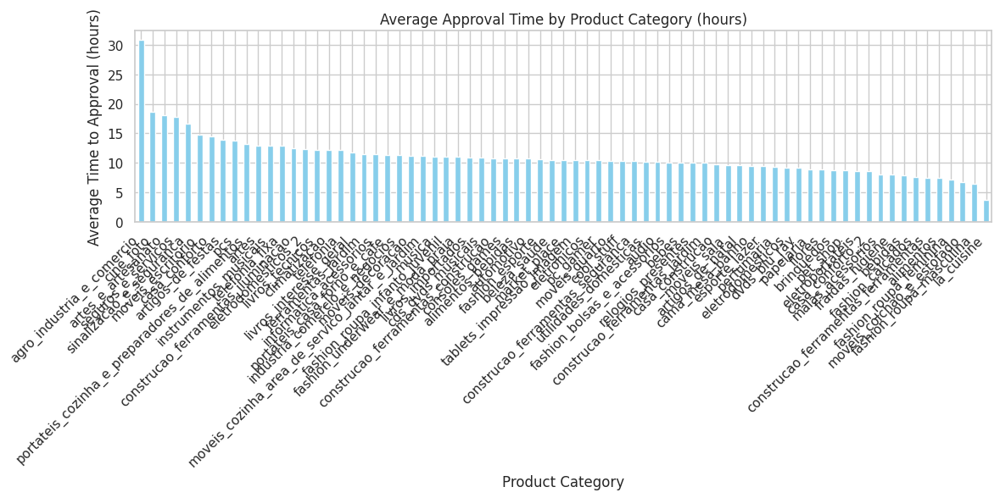

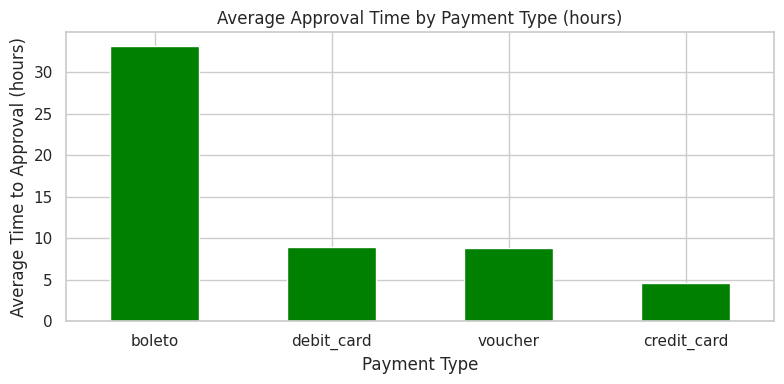

In [27]:
# Set plot style
sns.set(style="whitegrid")

# Plot for Product Category
plt.figure(figsize=(12, 6))
avg_approval_by_category.plot(kind='bar', color='skyblue')
plt.title('Average Approval Time by Product Category (hours)')
plt.xlabel('Product Category')
plt.ylabel('Average Time to Approval (hours)')
plt.xticks(rotation=45, ha="right")
plt.tight_layout()  # Adjust layout to make room for the rotated x-axis labels
plt.show()

# Plot for Payment Type
plt.figure(figsize=(8, 4))
avg_approval_by_payment.plot(kind='bar', color='green')
plt.title('Average Approval Time by Payment Type (hours)')
plt.xlabel('Payment Type')
plt.ylabel('Average Time to Approval (hours)')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

In [28]:
# Group by both 'product_category_name' and 'payment_type'
grouped_data = df_merged.groupby(['product_category_name', 'payment_type']).agg({
    'time_to_approval_hours': ['mean', 'median', 'count']
}).reset_index()

# Flatten the MultiIndex columns
grouped_data.columns = ['product_category_name', 'payment_type', 'avg_approval_time', 'median_approval_time', 'count']

# Filter out groups with very few data points to avoid skewed analysis
filtered_grouped_data = grouped_data[grouped_data['count'] > 10]

In [29]:
filtered_grouped_data

,product_category_name,payment_type,avg_approval_time,median_approval_time,count
0,agro_industria_e_comercio,boleto,37.346767,29.436111,58
1,agro_industria_e_comercio,credit_card,10.699180,0.335556,141
3,agro_industria_e_comercio,voucher,93.168347,163.896667,42
4,alimentos,boleto,27.533274,22.965000,103
5,alimentos,credit_card,2.047223,0.260556,373
...,...,...,...,...,...
263,telefonia_fixa,credit_card,7.564117,0.264167,183
266,utilidades_domesticas,boleto,35.289255,30.684444,1289
267,utilidades_domesticas,credit_card,4.342523,0.277778,5283
268,utilidades_domesticas,debit_card,6.126106,0.417778,111


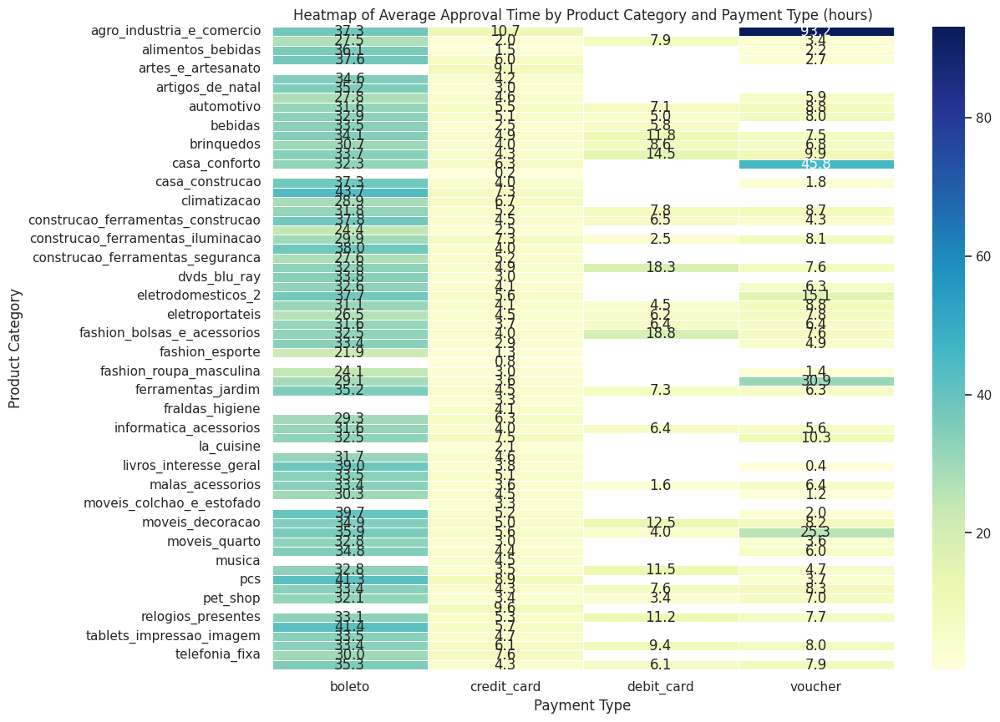

In [30]:
# Pivot the data for heatmap
pivot_table = filtered_grouped_data.pivot('product_category_name', 'payment_type', 'avg_approval_time')

# Draw a heatmap with the numeric values in each cell
plt.figure(figsize=(12, 10))
sns.heatmap(pivot_table, annot=True, fmt=".1f", linewidths=.5, cmap="YlGnBu")
plt.title('Heatmap of Average Approval Time by Product Category and Payment Type (hours)')
plt.xlabel('Payment Type')
plt.ylabel('Product Category')
plt.show()

In [31]:
# One-hot encode 'product_category_name' and 'payment_type'
one_hot_product = pd.get_dummies(df_merged['product_category_name'], prefix='Product')
one_hot_payment = pd.get_dummies(df_merged['payment_type'], prefix='Payment')

# Combine the one-hot encoded columns back with the approval time
df_features = pd.concat([df_merged['time_to_approval_hours'], one_hot_product, one_hot_payment], axis=1)


In [32]:
correlation_matrix = df_features.corr()
correlation_with_approval = correlation_matrix[['time_to_approval_hours']].sort_values(by='time_to_approval_hours', ascending=False)

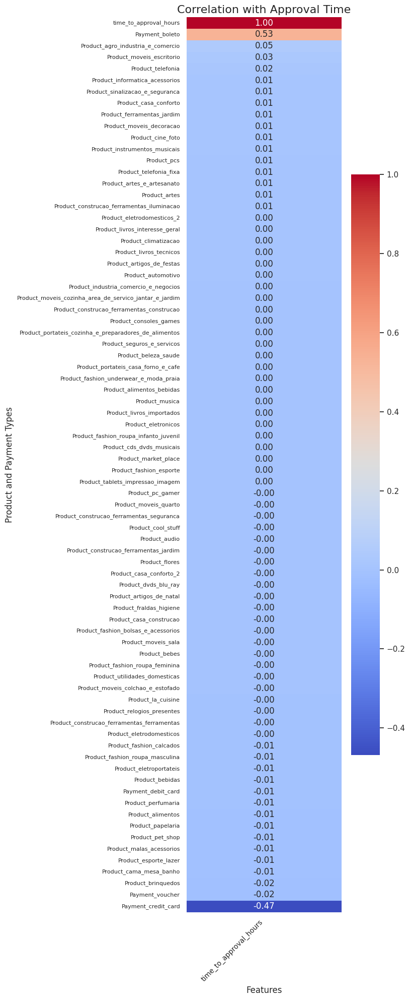

In [33]:
# Create a figure to handle size and resolution
plt.figure(figsize=(8, 20), dpi=100)

# Generate a heatmap
sns.heatmap(correlation_with_approval, annot=True, fmt=".2f", cmap='coolwarm', cbar=True,
            cbar_kws={"shrink": .8})

# Enhancements for clarity
plt.title('Correlation with Approval Time', fontsize=16)
plt.xlabel('Features', fontsize=12)
plt.ylabel('Product and Payment Types', fontsize=12)

# Rotate the x-axis labels for better readability
plt.xticks(rotation=45, ha='right', fontsize=10)

# Adjust y-axis labels for visibility
plt.yticks(fontsize=8)

# Show the plot
plt.tight_layout()
plt.show()


__There is a moderate positive correlation between using the boleto payment method and the approval time__. This suggests that orders paid by boleto tend to have longer approval times compared to other payment methods. It's possible that the boleto payment process, which typically involves bank processing and may depend on manual confirmation, inherently takes longer, thus delaying the approval.  
__There is a moderate negative correlation between credit card payments and approval times__. This suggests that orders paid by credit card are processed significantly faster than those paid by other methods. Credit card payments are often automated and processed electronically, which can lead to quicker approval times.

### Time between approval and delivery to carrier

In [34]:
df_merged['time_to_carrier'] = df_merged['order_delivered_carrier_date'] - df_merged['order_approved_at']

In [35]:
df_merged['time_to_carrier_hours'] = df_merged['time_to_carrier'] / pd.Timedelta(hours=1)
df_merged['time_to_carrier_days'] = df_merged['time_to_carrier'] / pd.Timedelta(days=1)

In [36]:
# Mean time to carrier by product category
avg_time_by_category = df_merged.groupby('product_category_name')['time_to_carrier_hours'].mean().sort_values(ascending=False)
avg_time_by_category

product_category_name
moveis_escritorio                                244.562754
fashion_calcados                                 125.373702
fashion_roupa_masculina                          111.715966
fashion_roupa_feminina                           110.005895
moveis_quarto                                    100.192176
                                                    ...    
artes_e_artesanato                                33.192824
portateis_cozinha_e_preparadores_de_alimentos     32.838492
cine_foto                                         32.486718
la_cuisine                                        30.720434
seguros_e_servicos                                21.952083
Name: time_to_carrier_hours, Length: 73, dtype: float64

<AxesSubplot:xlabel='time_to_carrier_hours', ylabel='Count'>

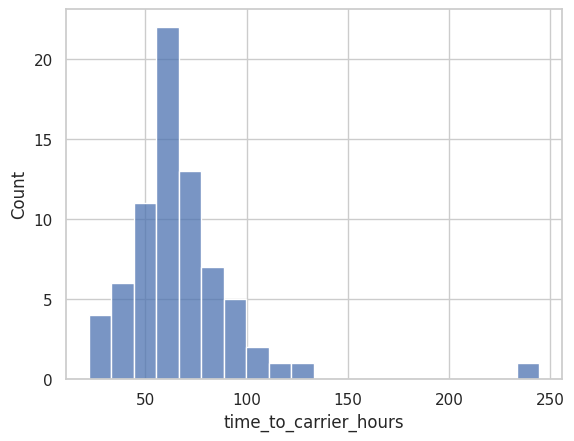

In [37]:
sns.histplot(avg_time_by_category, bins=20)

In [38]:
# Mean time to carrier by payment type
avg_time_by_payment = df_merged.groupby('payment_type')['time_to_carrier_hours'].mean().sort_values(ascending=False)
print("Average Time to Carrier by Payment Type:\n", avg_time_by_payment)

Average Time to Carrier by Payment Type:
 payment_type
voucher        69.632252
boleto         68.466697
credit_card    68.151069
debit_card     63.088537
Name: time_to_carrier_hours, dtype: float64


In [39]:
df_merged['is_delayed'] = df_merged['time_to_carrier_hours'] > 48

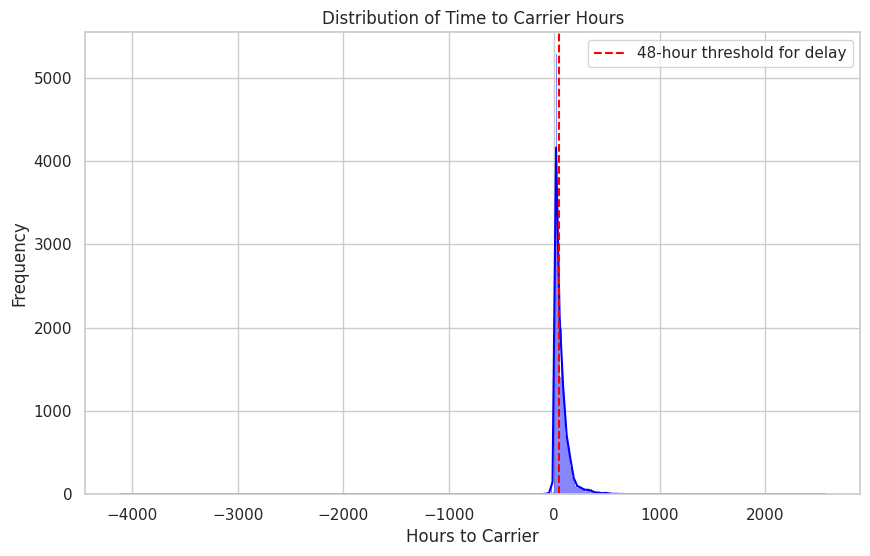

In [40]:
# Plot histogram
plt.figure(figsize=(10, 6))
sns.histplot(df_merged['time_to_carrier_hours'], color='blue', kde=True)
plt.axvline(48, color='red', linestyle='--', label='48-hour threshold for delay')
plt.title('Distribution of Time to Carrier Hours')
plt.xlabel('Hours to Carrier')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [41]:
# Filter for delayed orders
delayed_orders = df_merged[df_merged['is_delayed']]
delayed_orders

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,seller_zip_code_prefix,seller_city,seller_state,time_to_approval,time_to_approval_hours,time_to_approval_days,time_to_carrier,time_to_carrier_hours,time_to_carrier_days,is_delayed
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,9350,maua,SP,0 days 00:10:42,0.178333,0.007431,2 days 08:47:45,56.795833,2.366493,True
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,9350,maua,SP,0 days 00:10:42,0.178333,0.007431,2 days 08:47:45,56.795833,2.366493,True
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,9350,maua,SP,0 days 00:10:42,0.178333,0.007431,2 days 08:47:45,56.795833,2.366493,True
5,bfc39df4f36c3693ff3b63fcbea9e90a,53904ddbea91e1e92b2b3f1d09a7af86,delivered,2017-10-23 23:26:46,2017-10-25 02:14:11,2017-10-27 16:48:46,2017-11-07 18:04:59,2017-11-13,1,87285b34884572647811a353c7ac498a,...,9350,maua,SP,1 days 02:47:25,26.790278,1.116262,2 days 14:34:35,62.576389,2.607350,True
19,84aaa1a774e37a0a7c1a5413dc49e168,7cc4123da344ba5ca2fa23c0f7903fce,delivered,2017-07-21 10:03:34,2017-07-21 10:23:25,2017-07-25 19:45:28,2017-07-26 21:13:05,2017-08-03,1,725cbfcaff95a4d43742fdf13cf43c75,...,9350,maua,SP,0 days 00:19:51,0.330833,0.013785,4 days 09:22:03,105.367500,4.390313,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115002,a4e589b74835bc3afcbd2f9e8c5f7fd5,8b395f74a33054bc1e054c5b9348df51,delivered,2017-08-18 13:19:58,2017-08-22 04:16:21,2017-08-25 18:16:49,2017-09-01 17:32:10,2017-09-11,1,2701fc4808fcb783d1347510b8b16698,...,1417,sao paulo,SP,3 days 14:56:23,86.939722,3.622488,3 days 14:00:28,86.007778,3.583657,True
115005,80ba449ea98f8e879a829759b5a66294,0e07a801a6729369c02b88f4d38388cb,delivered,2018-02-25 17:37:45,2018-02-25 17:50:41,2018-02-28 20:43:49,2018-03-12 17:08:41,2018-03-27,1,cec29a60285cd686caa31318b3ad3671,...,80010,curitiba,PR,0 days 00:12:56,0.215556,0.008981,3 days 02:53:08,74.885556,3.120231,True
115011,5bacbd9f42bd029c3a296501224e193e,5a1470d43d8ad960d4199134d3df48e0,delivered,2018-08-10 21:14:35,2018-08-10 21:25:22,2018-08-13 13:54:00,2018-08-21 04:16:31,2018-08-30,1,710e8b076db06c8e5343a9e23f0e3d83,...,88490,paulo lopes,SC,0 days 00:10:47,0.179722,0.007488,2 days 16:28:38,64.477222,2.686551,True
115012,5bacbd9f42bd029c3a296501224e193e,5a1470d43d8ad960d4199134d3df48e0,delivered,2018-08-10 21:14:35,2018-08-10 21:25:22,2018-08-13 13:54:00,2018-08-21 04:16:31,2018-08-30,2,710e8b076db06c8e5343a9e23f0e3d83,...,88490,paulo lopes,SC,0 days 00:10:47,0.179722,0.007488,2 days 16:28:38,64.477222,2.686551,True


In [42]:
total_orders=df_merged.groupby('product_category_name').size()
total_orders


product_category_name
agro_industria_e_comercio     246
alimentos                     515
alimentos_bebidas             279
artes                         207
artes_e_artesanato             24
                             ... 
sinalizacao_e_seguranca       199
tablets_impressao_imagem       87
telefonia                    4601
telefonia_fixa                261
utilidades_domesticas        7172
Length: 73, dtype: int64

In [43]:
#Statistics delayed orders by product category
delays_by_category = delayed_orders.groupby('product_category_name').agg(
    average_delay=('time_to_carrier_hours', 'mean'),
    delay_count=('is_delayed', 'sum')).sort_values('average_delay', ascending=False)
    
delays_by_category['delay_percentage'] = (delays_by_category['delay_count'] / total_orders) * 100
delays_by_category

,average_delay,delay_count,delay_percentage
product_category_name,,,
moveis_escritorio,263.862586,1614,92.070736
fashion_roupa_masculina,167.482774,84,60.869565
climatizacao,162.234259,145,49.319728
fashion_calcados,155.271432,207,76.951673
fashion_roupa_feminina,151.331444,30,66.666667
...,...,...,...
malas_acessorios,88.169989,340,29.616725
cds_dvds_musicais,84.609960,7,50.000000
artigos_de_festas,70.317794,17,37.777778


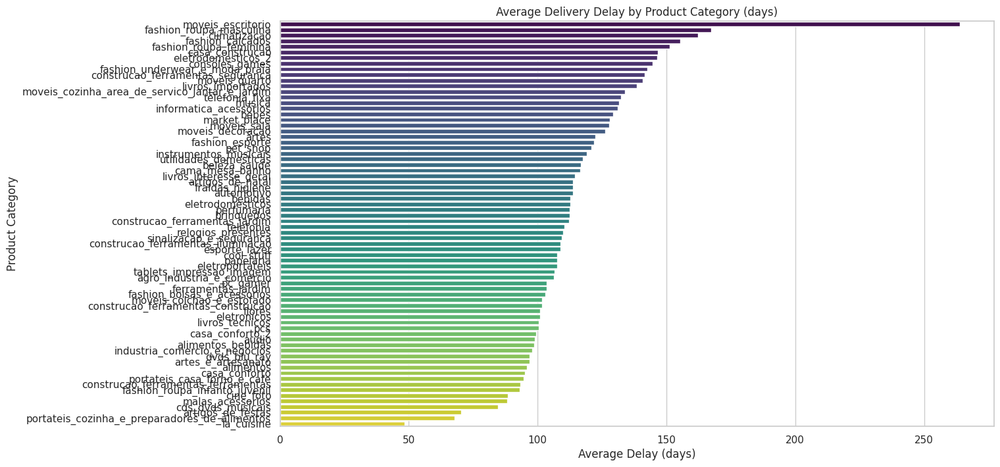

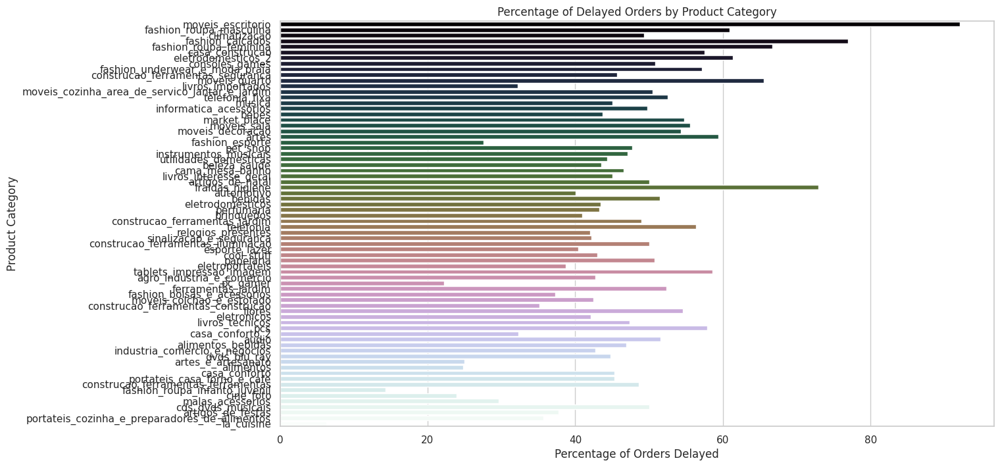

In [44]:
# Set plot style
sns.set(style="whitegrid")

# Plot the average delay by product category
plt.figure(figsize=(14, 8))
sns.barplot(x='average_delay', y=delays_by_category.index, data=delays_by_category, palette="viridis")
plt.title('Average Delivery Delay by Product Category (days)')
plt.xlabel('Average Delay (days)')
plt.ylabel('Product Category')
plt.show()

# Plot the percentage of delayed orders by product category
plt.figure(figsize=(14, 8))
sns.barplot(x='delay_percentage', y=delays_by_category.index, data=delays_by_category, palette="cubehelix")
plt.title('Percentage of Delayed Orders by Product Category')
plt.xlabel('Percentage of Orders Delayed')
plt.ylabel('Product Category')
plt.show()


In [45]:
delays_by_category.sort_values('delay_percentage', ascending=False, inplace=True)

<AxesSubplot:xlabel='delay_percentage', ylabel='Count'>

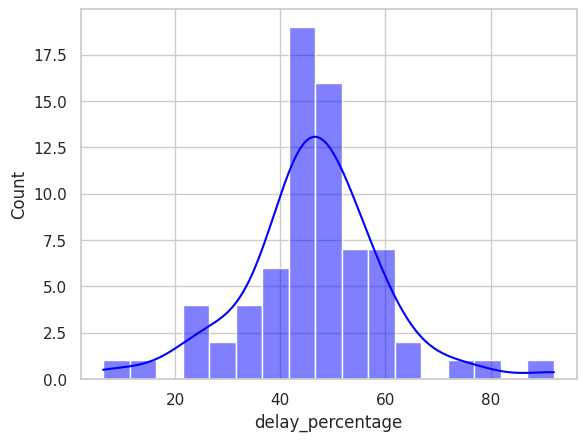

In [46]:
sns.histplot(delays_by_category['delay_percentage'], color='blue', kde=True)

In [47]:
delays=delays_by_category[delays_by_category['delay_percentage']>40]

In [48]:
# Join the top delayed products with the main DataFrame to analyze these variables
top_delayed_df = df_merged[df_merged['product_category_name'].isin(delays.index)]

# Group by relevant factors like 'seller_city', 'seller_state', 'carrier' (if available)
# Example: Analyzing delays by seller location
#delays_by_seller_location = top_delayed_df.groupby(['seller_state'])['delivery_delay_days'].mean().sort_values(ascending=False)
#print(delays_by_seller_location)


In [49]:
seller_location=top_delayed_df.groupby(['seller_city'])['time_to_carrier_hours'].mean().sort_values(ascending=False)

In [50]:
seller_location

seller_city
bom jesus dos perdoes              1087.587500
portoferreira                       734.377778
santo antonio da patrulha           695.695278
sao paulo sp                        456.773889
santa maria da serra                415.617556
                                      ...     
lambari                               4.000972
sao sebastiao da grama/sp             2.547222
rio de janeiro / rio de janeiro       0.466389
avare                               -22.734722
bom jardim                          -58.272361
Name: time_to_carrier_hours, Length: 572, dtype: float64

In [51]:
seller_location_df=pd.DataFrame(data=seller_location)

In [52]:
seller_location_df

,time_to_carrier_hours
seller_city,
bom jesus dos perdoes,1087.587500
portoferreira,734.377778
santo antonio da patrulha,695.695278
sao paulo sp,456.773889
santa maria da serra,415.617556
...,...
lambari,4.000972
sao sebastiao da grama/sp,2.547222
rio de janeiro / rio de janeiro,0.466389


In [53]:
map_df=pd.merge(seller_location_df, geolocation,  left_on="seller_city", right_on="geolocation_city", how="inner")

In [54]:
map_df.drop_duplicates(subset=['time_to_carrier_hours'], inplace=True)

In [55]:
map_df.to_csv('geolocation_seller_cluster.csv', index=False)

In [56]:
#Create a map centered around an average location
map_center_latitude = map_df['geolocation_lat'].mean()
map_center_longitude = map_df['geolocation_lng'].mean()
mymap = folium.Map(location=[map_center_latitude, map_center_longitude], zoom_start=6)

# Create clusters
marker_cluster = MarkerCluster().add_to(mymap)

# Add markers
for idx, row in map_df.iterrows():
    folium.Marker(
        location=[row['geolocation_lat'], row['geolocation_lng']],
        popup=f"{row['geolocation_city']} Value: {row['time_to_carrier_hours']}",
        icon=folium.Icon(color='red' if row['time_to_carrier_hours'] > 20 else 'green', icon='info-sign')
    ).add_to(marker_cluster)

# Display the map
mymap



In [57]:
# Assuming map_df is your DataFrame and it's already loaded
map_center_latitude = map_df['geolocation_lat'].mean()
map_center_longitude = map_df['geolocation_lng'].mean()
mymap = folium.Map(location=[map_center_latitude, map_center_longitude], zoom_start=6)

# Define a scale factor to control the size of the circles
scale_factor = 35  # You might need to adjust this depending on your specific values

# Add circles
for idx, row in map_df.iterrows():
    folium.Circle(
        location=[row['geolocation_lat'], row['geolocation_lng']],
        radius=row['time_to_carrier_hours'] * 20,  # Adjust multiplication factor as needed for visibility
        color='blue',
        fill=True,
        fill_color='blue',
        popup=f"<strong>City:</strong> {row['geolocation_city']}<br><strong>Delay:</strong> {row['time_to_carrier_hours']} hours",
        tooltip=f"{row['geolocation_city']}: {row['time_to_carrier_hours']} hours delay"
    ).add_to(mymap)
mymap


In [58]:
# Calculate descriptive statistics
descriptive_stats = top_delayed_df[['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm']].describe()
descriptive_stats

,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,107697.000000,107697.000000,107697.000000,107697.000000
mean,2101.332915,30.517777,16.614437,23.145714
std,3711.255211,16.239778,13.296678,11.751139
min,0.000000,7.000000,2.000000,6.000000
25%,300.000000,18.000000,8.000000,15.000000
50%,700.000000,25.000000,13.000000,20.000000
75%,1813.000000,38.000000,20.000000,30.000000
max,40425.000000,105.000000,105.000000,118.000000


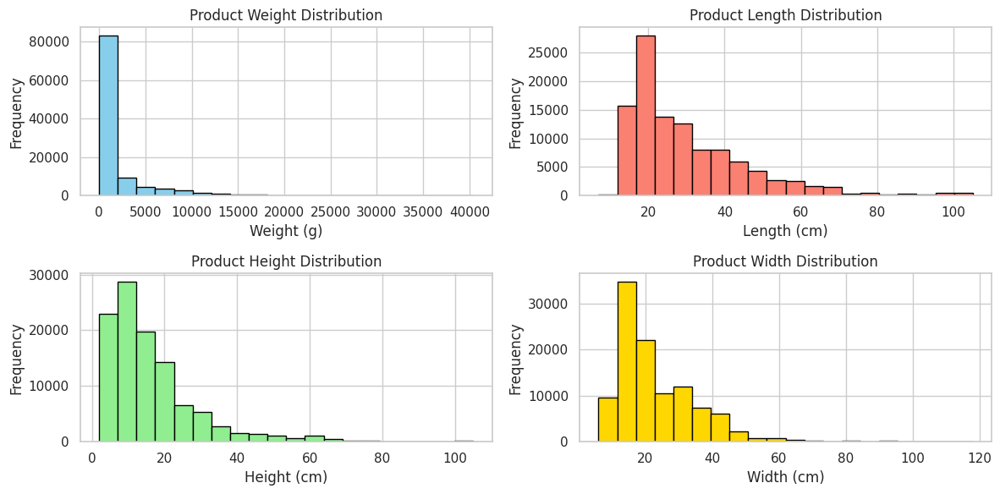

In [59]:
# Visualize distributions
plt.figure(figsize=(12, 6))
plt.subplot(2, 2, 1)
plt.hist(top_delayed_df['product_weight_g'], bins=20, color='skyblue', edgecolor='black')
plt.title('Product Weight Distribution')
plt.xlabel('Weight (g)')
plt.ylabel('Frequency')

plt.subplot(2, 2, 2)
plt.hist(top_delayed_df['product_length_cm'], bins=20, color='salmon', edgecolor='black')
plt.title('Product Length Distribution')
plt.xlabel('Length (cm)')
plt.ylabel('Frequency')

plt.subplot(2, 2, 3)
plt.hist(top_delayed_df['product_height_cm'], bins=20, color='lightgreen', edgecolor='black')
plt.title('Product Height Distribution')
plt.xlabel('Height (cm)')
plt.ylabel('Frequency')

plt.subplot(2, 2, 4)
plt.hist(top_delayed_df['product_width_cm'], bins=20, color='gold', edgecolor='black')
plt.title('Product Width Distribution')
plt.xlabel('Width (cm)')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


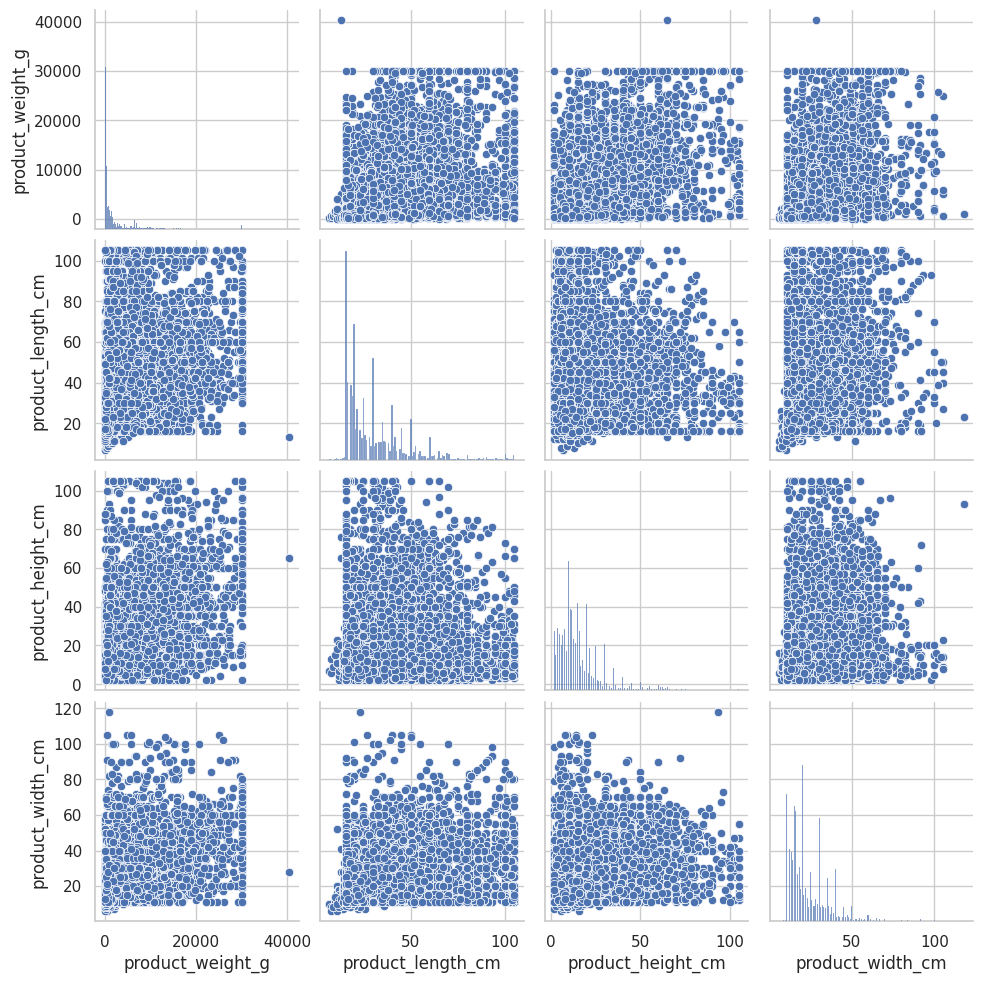

In [60]:
sns.pairplot(top_delayed_df[['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm']])
plt.show()

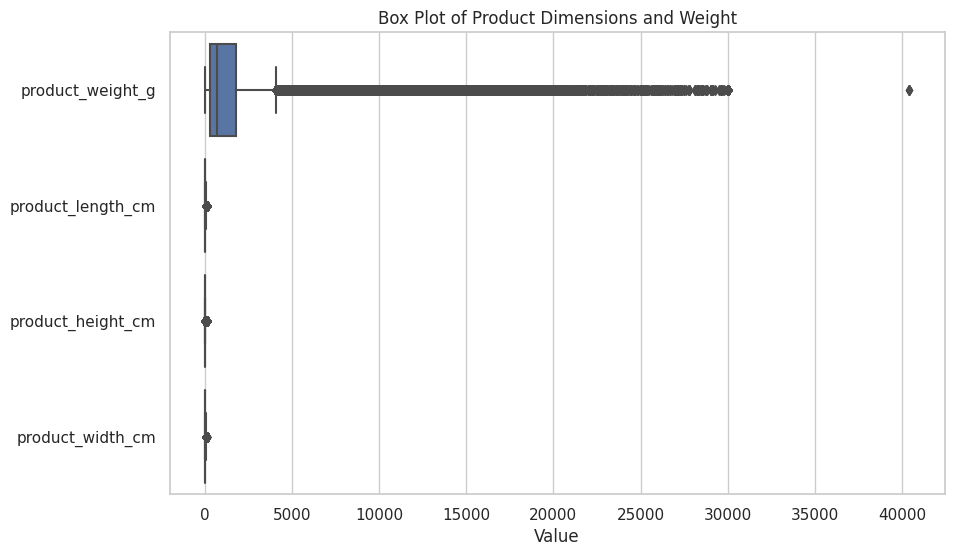

In [61]:
# Box plot for outlier detection
plt.figure(figsize=(10, 6))
sns.boxplot(data=top_delayed_df[['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm']], orient='h')
plt.title('Box Plot of Product Dimensions and Weight')
plt.xlabel('Value')
plt.show()


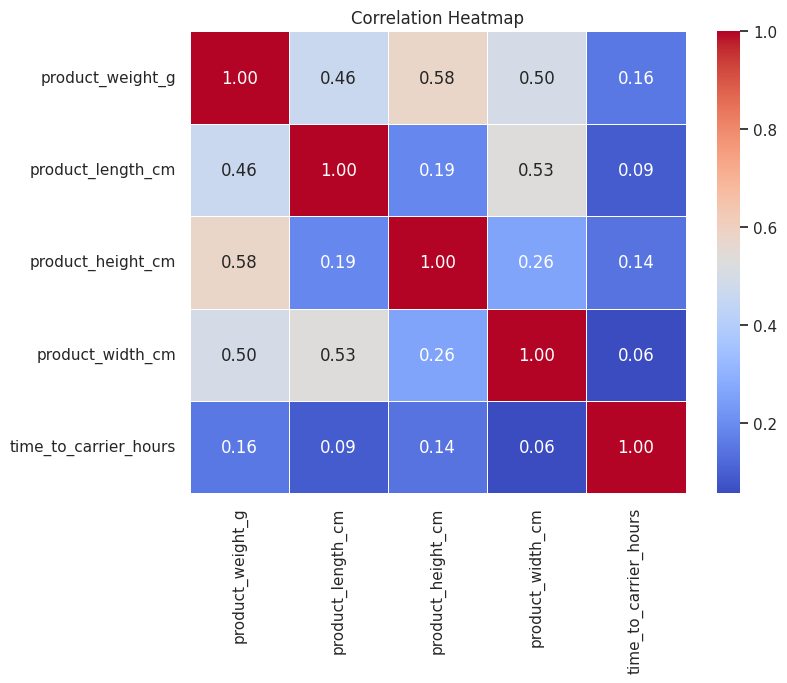

In [62]:
# Calculate correlation coefficients
correlation_matrix = top_delayed_df[['product_weight_g', 'product_length_cm', 'product_height_cm', 'product_width_cm', 'time_to_carrier_hours']].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()


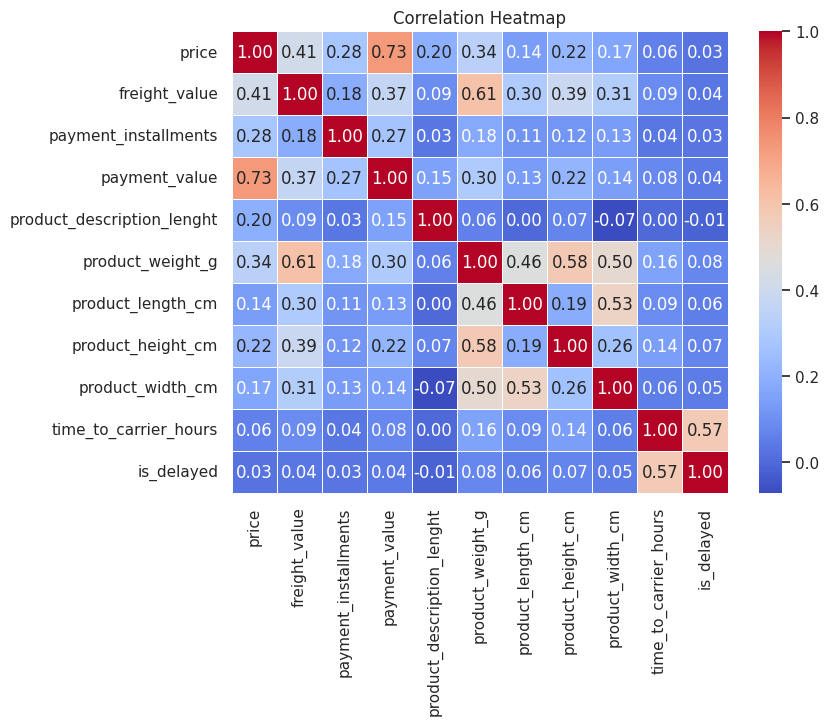

In [63]:
correlation_matrix_freight = top_delayed_df[[ 'price', 'freight_value', 'payment_type',
       'payment_installments', 'payment_value', 'product_category_name',
        'product_description_lenght',
        'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'customer_unique_id',
        'customer_city', 'customer_state',
        'seller_city', 'seller_state',
       'time_to_carrier_hours', 'is_delayed']].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix_freight, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()


### Time between carrier and customer delivery

In [64]:
df_merged['time_to_customer'] = df_merged['order_delivered_customer_date'] - df_merged['order_delivered_carrier_date']

In [65]:
df_merged['time_to_customer_hours'] = df_merged['time_to_customer'] / pd.Timedelta(hours=1)
df_merged['time_to_customer_days'] = df_merged['time_to_customer'] / pd.Timedelta(days=1)

In [66]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 113390 entries, 0 to 115017
Data columns (total 43 columns):
 #   Column                         Non-Null Count   Dtype          
---  ------                         --------------   -----          
 0   order_id                       113390 non-null  object         
 1   customer_id                    113390 non-null  object         
 2   order_status                   113390 non-null  object         
 3   order_purchase_timestamp       113390 non-null  datetime64[ns] 
 4   order_approved_at              113390 non-null  datetime64[ns] 
 5   order_delivered_carrier_date   113390 non-null  datetime64[ns] 
 6   order_delivered_customer_date  113390 non-null  datetime64[ns] 
 7   order_estimated_delivery_date  113390 non-null  datetime64[ns] 
 8   order_item_id                  113390 non-null  int64          
 9   product_id                     113390 non-null  object         
 10  seller_id                      113390 non-null  object  

In [67]:
# Mean time to carrier by product category
avg_time_by_category_delivery = df_merged.groupby('product_category_name')['time_to_customer_hours'].mean().sort_values(ascending=False)
avg_time_by_category_delivery

product_category_name
seguros_e_servicos                               323.635000
artigos_de_natal                                 297.966051
casa_conforto_2                                  286.974776
moveis_colchao_e_estofado                        274.196229
casa_conforto                                    257.778691
                                                    ...    
construcao_ferramentas_iluminacao                153.599326
la_cuisine                                       151.519392
portateis_cozinha_e_preparadores_de_alimentos    149.389762
livros_importados                                134.168437
artes_e_artesanato                                86.065046
Name: time_to_customer_hours, Length: 73, dtype: float64

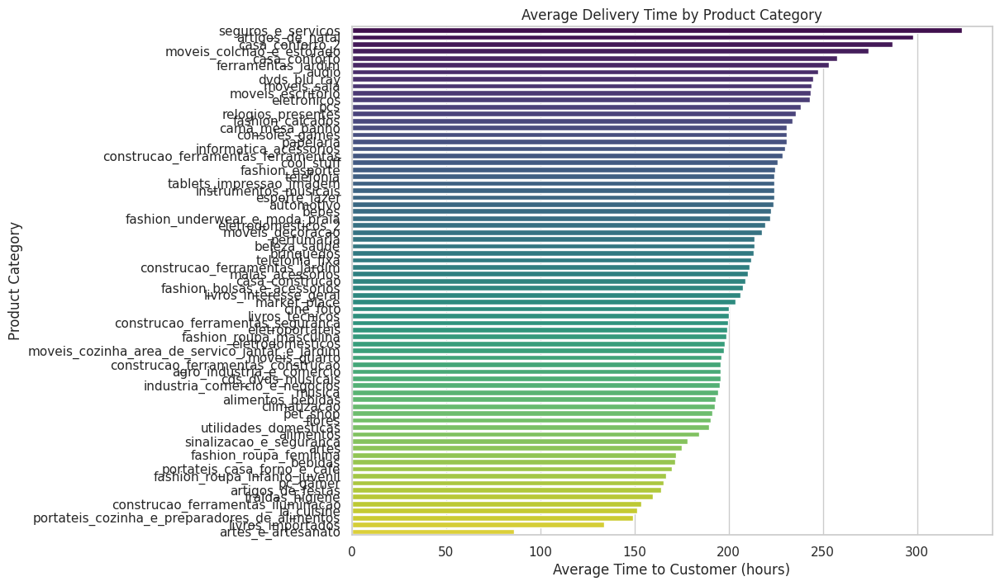

In [68]:
# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Initialize the matplotlib figure
plt.figure(figsize=(10, 8))

# Create a bar plot
sns.barplot(
    x=avg_time_by_category_delivery.values,
    y=avg_time_by_category_delivery.index,
    palette="viridis"  # This gives a nice color gradient; adjust the palette as desired
)

# Add labels and title
plt.xlabel('Average Time to Customer (hours)')
plt.ylabel('Product Category')
plt.title('Average Delivery Time by Product Category')

# Show the plot
plt.show()


### Time between estimated delivery and actual delivery to the customer

In [69]:
df_merged['delivery_vs_estimated'] = df_merged['order_delivered_customer_date'] - df_merged['order_estimated_delivery_date']

In [70]:
df_merged['delivery_vs_estimated_hours'] = df_merged['delivery_vs_estimated'] / pd.Timedelta(hours=1)
df_merged['delivery_vs_estimated_days'] = df_merged['delivery_vs_estimated'] / pd.Timedelta(days=1)

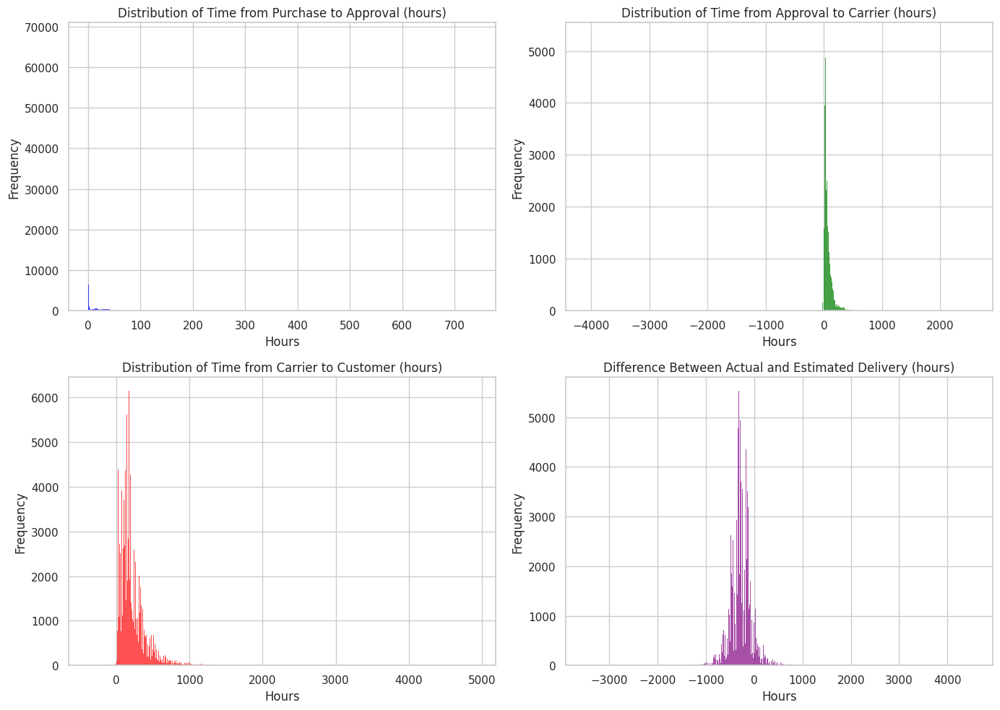

In [71]:
# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create a figure to contain the subplots
plt.figure(figsize=(14, 10))

# Histogram of Time to Approval
plt.subplot(2, 2, 1)  # 2 rows, 2 columns, 1st subplot
sns.histplot(df_merged['time_to_approval_hours'], kde=False, color='blue')
plt.title('Distribution of Time from Purchase to Approval (hours)')
plt.xlabel('Hours')
plt.ylabel('Frequency')

# Histogram of Time to Carrier
plt.subplot(2, 2, 2)
sns.histplot(df_merged['time_to_carrier_hours'], kde=False, color='green')
plt.title('Distribution of Time from Approval to Carrier (hours)')
plt.xlabel('Hours')
plt.ylabel('Frequency')

# Histogram of Time to Customer
plt.subplot(2, 2, 3)
sns.histplot(df_merged['time_to_customer_hours'], kde=False, color='red')
plt.title('Distribution of Time from Carrier to Customer (hours)')
plt.xlabel('Hours')
plt.ylabel('Frequency')

# Histogram of Delivery vs. Estimated
plt.subplot(2, 2, 4)
sns.histplot(df_merged['delivery_vs_estimated_hours'], kde=False, color='purple')
plt.title('Difference Between Actual and Estimated Delivery (hours)')
plt.xlabel('Hours')
plt.ylabel('Frequency')

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


In [72]:
avg_delivery_delay_by_category = df_merged.groupby('product_category_name')['delivery_vs_estimated_hours'].mean().sort_values(ascending=False)
avg_delivery_delay_by_category

product_category_name
artes_e_artesanato                              -146.206123
moveis_colchao_e_estofado                       -155.531819
casa_conforto_2                                 -188.413127
portateis_cozinha_e_preparadores_de_alimentos   -210.379286
casa_conforto                                   -217.360356
                                                    ...    
fashion_calcados                                -338.644212
fashion_roupa_infanto_juvenil                   -359.867143
la_cuisine                                      -379.430556
cds_dvds_musicais                               -386.328710
seguros_e_servicos                              -390.678333
Name: delivery_vs_estimated_hours, Length: 73, dtype: float64

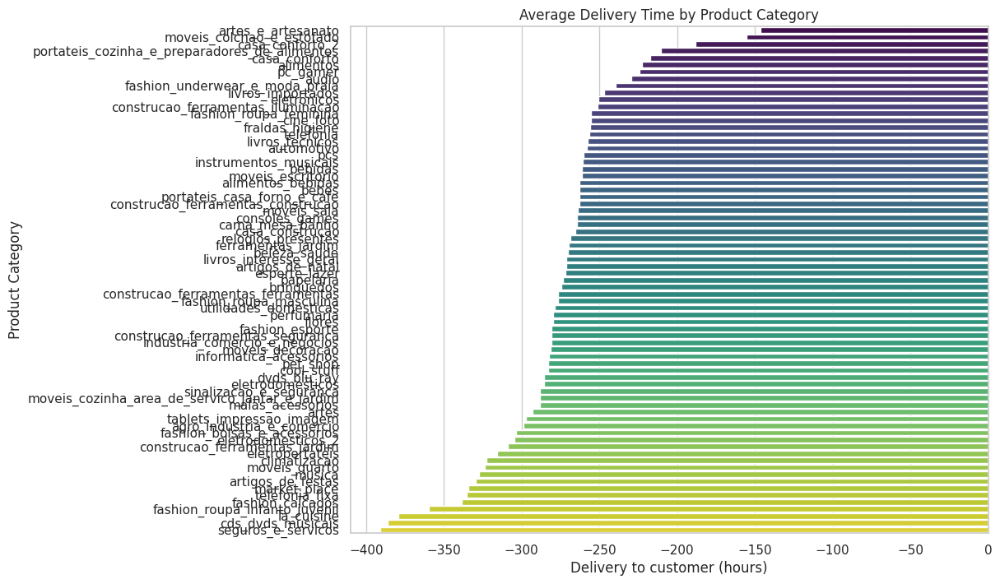

In [73]:
sns.set_style("whitegrid")

# Initialize the matplotlib figure
plt.figure(figsize=(10, 8))

# Create a bar plot
sns.barplot(
    x=avg_delivery_delay_by_category.values,
    y=avg_delivery_delay_by_category.index,
    palette="viridis"  # This gives a nice color gradient; adjust the palette as desired
)

# Add labels and title
plt.xlabel('Delivery to customer (hours)')
plt.ylabel('Product Category')
plt.title('Average Delivery Time by Product Category')

# Show the plot
plt.show()

In [74]:
df_merged['delivery_delay'] = df_merged['delivery_vs_estimated_hours'] > 0

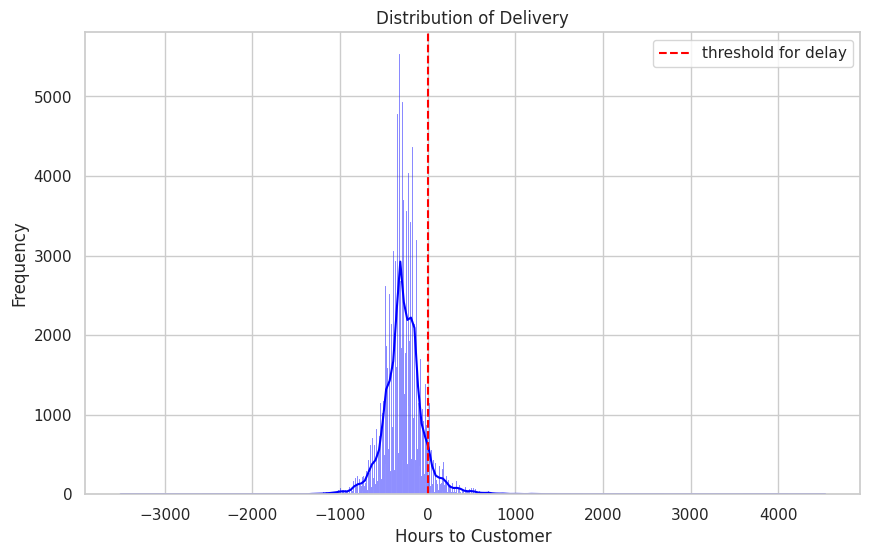

In [75]:
# Plot histogram
plt.figure(figsize=(10, 6))
sns.histplot(df_merged['delivery_vs_estimated_hours'], color='blue', kde=True)
plt.axvline(0, color='red', linestyle='--', label='threshold for delay')
plt.title('Distribution of Delivery')
plt.xlabel('Hours to Customer')
plt.ylabel('Frequency')
plt.legend()
plt.show()

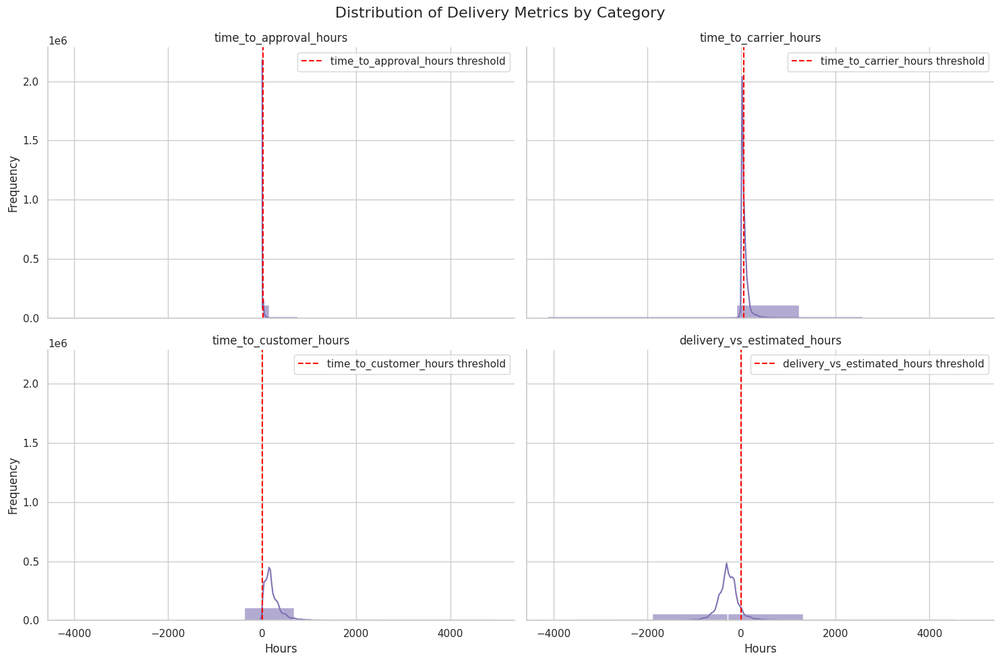

In [76]:
data_melted = df_merged.melt(value_vars=['time_to_approval_hours', 'time_to_carrier_hours', 'time_to_customer_hours', 'delivery_vs_estimated_hours'],
                             var_name='Metric', value_name='Hours')

# Create a FacetGrid, assigning each metric its own subplot
g = sns.FacetGrid(data_melted, col="Metric", col_wrap=2, height=5, aspect=1.5)
g.map(sns.histplot, 'Hours', kde=True, bins=5, color="m", alpha=0.6)

# Add vertical lines for specific thresholds (if applicable)
thresholds = {
    'time_to_approval_hours': 12,
    'time_to_carrier_hours': 48,
    'time_to_customer_hours': 0,
    'delivery_vs_estimated_hours': 0
}

for ax, metric in zip(g.axes.flatten(), thresholds):
    ax.axvline(x=thresholds[metric], color='red', linestyle='--', label=f'{metric} threshold')
    ax.legend()

# Enhance the visual layout
g.set_titles("{col_name}")
g.set_axis_labels('Hours', 'Frequency')
g.fig.suptitle('Distribution of Delivery Metrics by Category', fontsize=16)
g.fig.subplots_adjust(top=0.92)  # Adjust the top to make room for the title

# Show the plot
plt.show()



In [77]:
fig = go.Figure()

# Adding histograms to the figure
fig.add_trace(go.Histogram(x=df_merged['time_to_approval_days'], name='Time to Approval', marker_color='blue', opacity=0.6))
fig.add_trace(go.Histogram(x=df_merged['time_to_carrier_days'], name='Time to Carrier', marker_color='grey', opacity=0.6))
fig.add_trace(go.Histogram(x=df_merged['time_to_customer_days'], name='Time to Customer', marker_color='purple', opacity=0.6))
fig.add_trace(go.Histogram(x=df_merged['delivery_vs_estimated_days'], name='Delivery vs. Estimated', marker_color='green', opacity=0.6))

# Add vertical lines using shapes for the threshold
thresholds = [
    dict(type="line", x0=12, x1=12, y0=0, y1=1, xref="x", yref="paper", line_width=2, line_dash="dash", line_color="blue"),
    dict(type="line", x0=48, x1=48, y0=0, y1=1, xref="x", yref="paper", line_width=2, line_dash="dash", line_color="grey"),
    dict(type="line", x0=0, x1=0, y0=0, y1=1, xref="x", yref="paper", line_width=2, line_dash="dash", line_color="green")
]

fig.update_layout(
    title='Distribution of Various Delivery Metrics',
    xaxis_title='Days',
    yaxis_title='Frequency',
    barmode='overlay',  # This makes the histograms overlay
    shapes=thresholds,  # Adding the threshold lines
    legend_title="Legend"
)

# Set x-axis range if needed
fig.update_xaxes(range=[-75, 100])

# Show the figure
fig.show()


In [78]:
# Add a new column categorizing the delivery timing
df_merged['delivery_status'] = df_merged['delivery_vs_estimated_hours'].apply(
    lambda x: 'Early' if x < 0 else ('On Time' if 0 <= x <= 12 else 'Late')
)


In [79]:
# Group by product category and delivery status, then count
count_delivery_status_by_category = df_merged.groupby(['product_category_name', 'delivery_status']).size().unstack(fill_value=0)

# This will create a DataFrame with 'Early', 'On Time', and 'Late' columns
print(count_delivery_status_by_category)


delivery_status            Early  Late  On Time
product_category_name                          
agro_industria_e_comercio    237     9        0
alimentos                    465    46        4
alimentos_bebidas            262    16        1
artes                        192    15        0
artes_e_artesanato            22     1        1
...                          ...   ...      ...
sinalizacao_e_seguranca      188     9        2
tablets_impressao_imagem      81     6        0
telefonia                   4212   378       11
telefonia_fixa               250    11        0
utilidades_domesticas       6704   452       16

[73 rows x 3 columns]


In [80]:
# Sort categories by the total number of deliveries
count_delivery_status_by_category['Total'] = count_delivery_status_by_category.sum(axis=1)
count_delivery_status_by_category = count_delivery_status_by_category.sort_values(by='Total', ascending=False).drop(columns='Total')


In [81]:
# Sort categories by the total number of deliveries
count_delivery_status_by_category['Total'] = count_delivery_status_by_category.sum(axis=1)
count_delivery_status_by_category = count_delivery_status_by_category.sort_values(by='Total', ascending=False).drop(columns='Total')


In [82]:
# Create a figure
fig = go.Figure()

# Add bar for each status
colors = {'Early': 'green', 'On Time': 'gold', 'Late': 'red'}
for status, color in colors.items():
    fig.add_trace(go.Bar(
        x=count_delivery_status_by_category.index,
        y=count_delivery_status_by_category[status],
        name=status,
        marker_color=color
    ))

# Update layout for stacked bar chart
fig.update_layout(
    barmode='stack',
    title='Number of Products Delivered Early, On Time, and Late by Product Category',
    xaxis_title='Product Category Name',
    yaxis_title='Number of Products',
    legend_title='Delivery Status'
)

# Rotate the labels on the x-axis for better readability
fig.update_xaxes(tickangle=45)

# Show the figure
fig.show()




In [83]:
# Create a figure to hold both the bar chart and the table
fig = go.Figure()


# Add a table to display the numeric data
fig.add_trace(
    go.Table(
        header=dict(values=['Product Category', 'Early', 'On Time', 'Late'],
                    fill_color='paleturquoise',
                    align='left'),
        cells=dict(values=[
            count_delivery_status_by_category.index,  # Product Category Names
            count_delivery_status_by_category['Early'],  # Early Counts
            count_delivery_status_by_category['On Time'],  # On Time Counts
            count_delivery_status_by_category['Late']  # Late Counts
        ],
        fill_color='lavender',
        align='left')
    )
)

# Positioning the table below the bar chart
fig.update_layout(
    margin=dict(l=20, r=20, t=100, b=20),
    height=800  # Adjust height to accommodate both chart and table
)

# Show the combined figure
fig.show()

In [84]:
df_merged['order_purchase_timestamp'] = pd.to_datetime(df_merged['order_purchase_timestamp'])

# Filter late deliveries
late_deliveries = df_merged[df_merged['delivery_status'] == 'Late']

# Aggregate the count of late deliveries over time (e.g., monthly)
late_deliveries_timeline = late_deliveries.resample('M', on='order_purchase_timestamp').size().reset_index(name='count')

# Create a line plot
fig = px.line(late_deliveries_timeline, x='order_purchase_timestamp', y='count', 
              title='Distribution of Late Deliveries Over Time',
              labels={'order_purchase_timestamp': 'Date', 'count': 'Number of Late Deliveries'},
              template='plotly_white')

# Show the plot
fig.show()
